In [1]:
import os

import numpy as np
from PIL import Image
from tqdm.notebook import tnrange

from src.model import Model
from src.util import Const
import matplotlib.pyplot as plt

In [2]:
X = []
Y = []
with open(Const.LABELS_FILE_PATH, mode='r') as labels_file:
    lines = labels_file.readlines()
    for i in tnrange(len(lines)):
        values = lines[i].split(':')
        X.append(np.array(Image.open(os.path.join(Const.IMAGES_PATH, values[0]))))
        Y.append(float(values[1].strip('\n')))

  0%|          | 0/1408 [00:00<?, ?it/s]

In [3]:
model = Model()
model.set_data(X, Y)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 450, 600, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 225, 300, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 225, 300, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 112, 150, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 150, 64)      36928     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 56, 75, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 56, 75, 64)        3

  0%|          | 0/1408 [00:00<?, ?it/s]

In [4]:
N = 1000
history = model.train(epochs=N)

Epoch 1/1000
141/141 [==============================] - 11s 77ms/step - loss: 0.0153 - rmse: 0.1238 - val_loss: 0.0110 - val_rmse: 0.1048

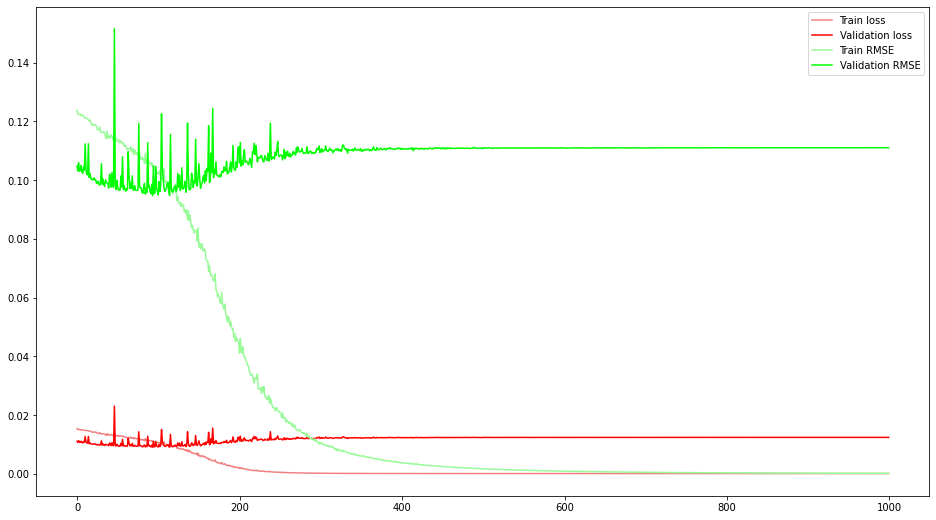

TypeError: imsave() missing 1 required positional argument: 'arr'

In [9]:
plt.figure(figsize=(16, 9))

plt.plot(range(N), history.history['loss'], color='lightcoral', label='Train loss')
plt.plot(range(N), history.history['val_loss'], color='red', label='Validation loss')

plt.plot(range(N), history.history['rmse'], color='palegreen', label='Train RMSE')
plt.plot(range(N), history.history['val_rmse'], color='lime', label='Validation RMSE')

plt.legend()
plt.show()
plt.imsave('res.png')

